# extTADA for separate steps

### This example describes steps to obtain results for de novo data. There are many steps used in this example. Users can use this example to customize plots/parameters for publications.

    
 ## Some main steps:
    
1. Estimate genetic parameters using MCCMC.

2. Use these parameters to calculate FDRs for each gene.
    

## Load source files of extTADA

In [7]:
fileR <- dir("../script", ".R$")
for (ii in fileR)
    source(paste0("../script/", ii))

Loading required package: ggplot2
Loading required package: StanHeaders
rstan (Version 2.16.2, packaged: 2017-07-03 09:24:58 UTC, GitRev: 2e1f913d3ca3)
For execution on a local, multicore CPU with excess RAM we recommend calling
rstan_options(auto_write = TRUE)
options(mc.cores = parallel::detectCores())
locfit 1.5-9.1 	 2013-03-22


In [8]:

N = list(dn = 1077, ca = 3157, cn = 4672)
inputData <- read.table("../data/SimulationDataDNandCC.txt", header = TRUE, as.is = TRUE)

head(inputData)

,Gene,mut_lof,mut_mis3,dn_lof,dn_mis3,cc_case1,cc_case2,cc_control1,cc_control2
1,G1,9.996657e-07,4.54062e-07,0,0,0,0,0,0
2,G2,1.420491e-07,1.04146e-10,0,0,0,0,0,0
3,G3,2.144318e-06,3.35199e-06,0,0,0,0,0,0
4,G4,3.981797e-06,7.82154e-06,0,0,0,0,0,0
5,G5,9.14698e-08,1.04146e-10,0,0,0,0,0,0
6,G6,3.779929e-06,2.85364e-06,0,0,0,0,0,0


In [9]:
allDNData <- inputData[, paste0("dn_", c("mis3", "lof"))]
allMutData <- inputData[,paste0("mut_", c("mis3", "lof"))]
head(data.frame(allMutData, allDNData))


,mut_mis3,mut_lof,dn_mis3,dn_lof
1,4.54062e-07,9.996657e-07,0,0
2,1.04146e-10,1.420491e-07,0,0
3,3.35199e-06,2.144318e-06,0,0
4,7.82154e-06,3.981797e-06,0,0
5,1.04146e-10,9.14698e-08,0,0
6,2.85364e-06,3.779929e-06,0,0


### Use the function *extTADA* to sample values of parameters

In [10]:
mcmcDD <- extTADAmcmc(modelName = DNextTADA, #extTADA for only de novo data
                  dataDN = allDNData, mutRate = allMutData, 
                  Ndn = rep(N$dn, 2), ## There are two de novo categories
                  nIteration = 1000)


There are 19358 genes in this analysis

=============FIRST TIME ===============


Sampling with nter = 1000 and nThin = 1


The model DNextTADA is used



In file included from /home/hoangnguyen/R/x86_64-pc-linux-gnu-library/3.2/BH/include/boost/config.hpp:39:0,
                 from /home/hoangnguyen/R/x86_64-pc-linux-gnu-library/3.2/BH/include/boost/math/tools/config.hpp:13,
                 from /home/hoangnguyen/R/x86_64-pc-linux-gnu-library/3.2/StanHeaders/include/stan/math/rev/core/var.hpp:7,
                 from /home/hoangnguyen/R/x86_64-pc-linux-gnu-library/3.2/StanHeaders/include/stan/math/rev/core/gevv_vvv_vari.hpp:5,
                 from /home/hoangnguyen/R/x86_64-pc-linux-gnu-library/3.2/StanHeaders/include/stan/math/rev/core.hpp:12,
                 from /home/hoangnguyen/R/x86_64-pc-linux-gnu-library/3.2/StanHeaders/include/stan/math/rev/mat.hpp:4,
                 from /home/hoangnguyen/R/x86_64-pc-linux-gnu-library/3.2/StanHeaders/include/stan/math.hpp:4,
                 from /home/hoangnguyen/R/x86_64-pc-linux-gnu-library/3.2/StanHeaders/include/src/stan/model/model_header.hpp:4,
                 from file12e0d5afd7c

### Take a quick look at the traces of parameters

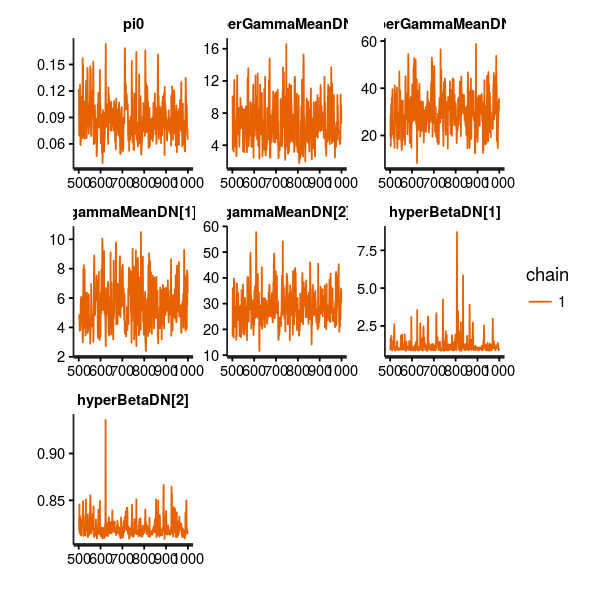

In [11]:
options(repr.plot.width=5, repr.plot.height=5)
stan_trace(mcmcDD)

In [12]:
mcmcDD

Inference for Stan model: 493590f0b50b55273a713acc3c2b8395.
1 chains, each with iter=1000; warmup=500; thin=1; 
post-warmup draws per chain=500, total post-warmup draws=500.

                        mean se_mean   sd     2.5%      25%      50%      75%
pi0                     0.09    0.00 0.02     0.05     0.07     0.09     0.10
hyperGammaMeanDN[1]     6.60    0.17 2.67     2.60     4.61     6.13     8.15
hyperGammaMeanDN[2]    29.60    0.61 8.35    15.19    23.50    29.30    34.62
gammaMeanDN[1]          5.53    0.11 1.49     3.18     4.48     5.26     6.46
gammaMeanDN[2]         28.87    0.50 6.78    17.56    24.23    28.07    32.96
hyperBetaDN[1]          1.22    0.04 0.60     0.86     0.94     1.05     1.25
hyperBetaDN[2]          0.82    0.00 0.01     0.81     0.81     0.82     0.82
lp__                -1771.70    0.10 1.49 -1775.23 -1772.46 -1771.41 -1770.64
                       97.5% n_eff Rhat
pi0                     0.14   184    1
hyperGammaMeanDN[1]    12.61   248    1
hyp

### Use the function *estimatePars* of extTADA to obtain modes, and credible intervals (ID) of parameters

In [13]:
pars0 <- estimatePars(pars = c('pi0',
                               'hyperGammaMeanDN[1]', 'hyperGammaMeanDN[2]',
                               'hyperBetaDN[1]', 'hyperBetaDN[2]'),
                     mcmcResult = mcmcDD)


====
Only pi and hyper parameters are estimated in this step
extTADA does not calculate HPDs for hyper betas, just their medians
===



In [14]:
pars0

,Mode,lCI,uCI
pi0,0.07889561,0.04738143,0.13488191
hyperGammaMeanDN[1],5.570321,2.253059,12.083404
hyperGammaMeanDN[2],29.32103,13.84757,46.75609
hyperBetaDN[1],1.045378,1.045378,1.045378
hyperBetaDN[2],0.8178659,0.8178659,0.8178659


### Use the function *plotParHeatmap* of extTADA to draw heatmaps of pairs of pars

Warning message:
In plot.xy(xy, type, ...): font width unknown for character 0x1Warning message:
In plot.xy(xy, type, ...): font metrics unknown for character 0x1Warning message:
In plot.xy(xy, type, ...): font width unknown for character 0x1Warning message:
In plot.xy(xy, type, ...): font metrics unknown for character 0x1

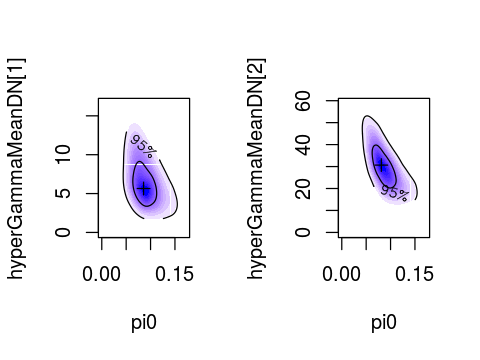

In [15]:
options(repr.plot.width=4, repr.plot.height=3)
par(mfrow = c(1, 2))
plotParHeatmap(pars = c("pi0", "hyperGammaMeanDN[1]"), mcmcResult = mcmcDD)
plotParHeatmap(pars = c("pi0", "hyperGammaMeanDN[2]"), mcmcResult = mcmcDD)


### Use function *calculateFDR* of extTADA to obtain FDRs of genes

In [20]:
##Get gene list
geneName <- inputData[, 1]
##Set parameters: use pars0 above
parsFDR <- list(gammaMeanDN = pars0[, 1][2:3],
                betaDN = pars0[, 1][4:5],
            pi0 = pars0[, 1][1],
            nfamily = rep(ntrioDD, 2))

dataFDR <- calculateFDR(pars = parsFDR,
                       dnData = allDNData, mutData = allMutData,
                       geneName = geneName)

No parameters for case-control data;  therefore, these categories are not calculated in this step.



In [21]:
head(dataFDR)

,Gene,dn_mis3,dn_lof,mut_mis3,mut_lof,BF,PP,qvalue
651,G651,2,2,3.01758e-06,1.078392e-06,20785.65,0.9994386,0.000561369
13294,G13294,0,3,9.19223e-06,8.024558e-06,2434.837,0.9952279,0.00266673
13582,G13582,0,2,7.85352e-07,7.324984e-07,716.2537,0.9839614,0.00712403
2815,G2815,0,2,4.94616e-06,2.519077e-06,384.3445,0.9705192,0.01271323
8387,G8387,0,2,3.92051e-06,3.447629e-06,314.9663,0.9642575,0.01731908
9500,G9500,0,2,4.89887e-06,3.585234e-06,293.1533,0.9616998,0.02081593


In [22]:
dim(dataFDR[dataFDR$qvalue < 0.1, ])
dim(dataFDR[dataFDR$qvalue < 0.05, ])

[1] 18  8

[1] 11  8

In [ ]:
rm(list=ls())